In [5]:
import numpy as np
import numpy as np
import pandas as pd
import importlib_resources
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


# Import af data og ændring så csv filen indeholder headers

In [6]:
# Import af data 
file_path = r'/Users/valdemarstamm/Desktop/DTU/2. Semester/Machine Learning/Project I/marketing.data.txt'

headers = [
    'Annual_Income', 'Sex', 'Marital_Status', 'Age', 'Education', 'Occupation',
    'Years_In_Area', 'Dual_Incomes', 'Persons_In_Household', 'Persons_In_Household_Under_18', 'Householder_Status',
    'Home_Type', 'Ethnicity', 'Language'
]

# Læs CSV-filen
df = pd.read_csv(file_path, header=None, names=headers, sep=' ', engine='python')

df.to_csv('corrected_data1.csv', index=False)
print("Data er gemt i 'corrected_data.csv'")

Data er gemt i 'corrected_data.csv'


# Laver columns

In [7]:
# Opdeler dataen i columns
columns = {} # Dict med kolonnenavne og værdier
for col in df.columns: #
    columns[col] = df[col]


for col, values in columns.items():
    print(f"{col}: {len(values)} values")

Annual_Income: 8993 values
Sex: 8993 values
Marital_Status: 8993 values
Age: 8993 values
Education: 8993 values
Occupation: 8993 values
Years_In_Area: 8993 values
Dual_Incomes: 8993 values
Persons_In_Household: 8993 values
Persons_In_Household_Under_18: 8993 values
Householder_Status: 8993 values
Home_Type: 8993 values
Ethnicity: 8993 values
Language: 8993 values


# Finder alle de missing værdier og giver overblik (kan evt finde de specifikke rækker)

In [8]:
# Tæller manglende værdier
missing_values_count = df.isnull().sum()
print(missing_values_count, "")


Annual_Income                      0
Sex                                0
Marital_Status                   160
Age                                0
Education                         86
Occupation                       136
Years_In_Area                    913
Dual_Incomes                       0
Persons_In_Household             375
Persons_In_Household_Under_18      0
Householder_Status               240
Home_Type                        357
Ethnicity                         68
Language                         359
dtype: int64 


# Udfører mode imputation

In [9]:

percentages = (df.isnull().sum() / len(df)) * 100
# Mode imputated udført på alle variabler
print("Mode imputation: \nNan erstattet med hyppigste kategori\n")

for col in df.columns:
    if df[col].isnull().sum() > 0:  # Kun imputer hvis der mangler værdier
        mode_value = df[col].mode()[0]
        df[col] = df[col].fillna(mode_value)
        print(f"{col}: NaN erstattet med {mode_value} ({percentages[col]:.2f}% manglende)")

# gemmer annual income til projekt2:
original_annual_income = df["Annual_Income"].copy() 

Mode imputation: 
Nan erstattet med hyppigste kategori

Marital_Status: NaN erstattet med 5.0 (1.78% manglende)
Education: NaN erstattet med 4.0 (0.96% manglende)
Occupation: NaN erstattet med 1.0 (1.51% manglende)
Years_In_Area: NaN erstattet med 5.0 (10.15% manglende)
Persons_In_Household: NaN erstattet med 2.0 (4.17% manglende)
Householder_Status: NaN erstattet med 2.0 (2.67% manglende)
Home_Type: NaN erstattet med 1.0 (3.97% manglende)
Ethnicity: NaN erstattet med 7.0 (0.76% manglende)
Language: NaN erstattet med 1.0 (3.99% manglende)


# Definer attributes labels

In [10]:
# Attributes og labels
attribute_labels = {
    'Annual_Income': [
        'Less than $10,000', '$10,000 - $14,999', '$15,000 - $19,999', '$20,000 - $24,999',
        '$25,000 - $29,999', '$30,000 - $39,999', '$40,000 - $49,999', '$50,000 - $74,999', '$75,000 or more'
    ],
    'Sex': ['Male', 'Female'],
    'Marital_Status': [
        'Married', 'Living together, not married', 'Divorced or separated', 'Widowed', 'Single, never married'
    ],
    'Age': ['14-17', '18-24', '25-34', '35-44', '45-54', '55-64', '65 and Over'],
    'Education': [
        'Grade 8 or less', 'Grades 9 to 11', 'Graduated high school', '1 to 3 years of college',
        'College graduate', 'Grad Study'
    ],
    'Occupation': [
        'Professional/Managerial', 'Sales Worker', 'Factory Worker/Laborer/Driver', 'Clerical/Service Worker',
        'Homemaker', 'Student, HS or College', 'Military', 'Retired', 'Unemployed'
    ],
    'Years_In_Area': [
        'Less than one year', 'One to three years', 'Four to six years', 'Seven to ten years', 'More than ten years'
    ],
    'Dual_Incomes': ['Dual income: Not married', 'Dual income: Yes', 'Dual income: No'],
    'Persons_In_Household': [
        'One', 'Two', 'Three', 'Four', 'Five', 'Six', 'Seven', 'Eight', 'Nine or more'
    ],
    'Persons_In_Household_Under_18': [
        'None', 'One', 'Two', 'Three', 'Four', 'Five', 'Six', 'Seven', 'Eight', 'Nine or more'
    ],
    'Householder_Status': ['Own House', 'Rented House', 'Live with Parents/Family'],
    'Home_Type': ['House', 'Condominium', 'Apartment', 'Mobile Home', 'House type: Other'],
    'Ethnicity': [
        'American Indian', 'Asian', 'Black', 'East Indian', 'Hispanic', 'Pacific Islander', 'White', 'Ethnicity: Other'
    ],
    'Language': ['English', 'Spanish', 'Language: Other']
}

# Plot hver attribute

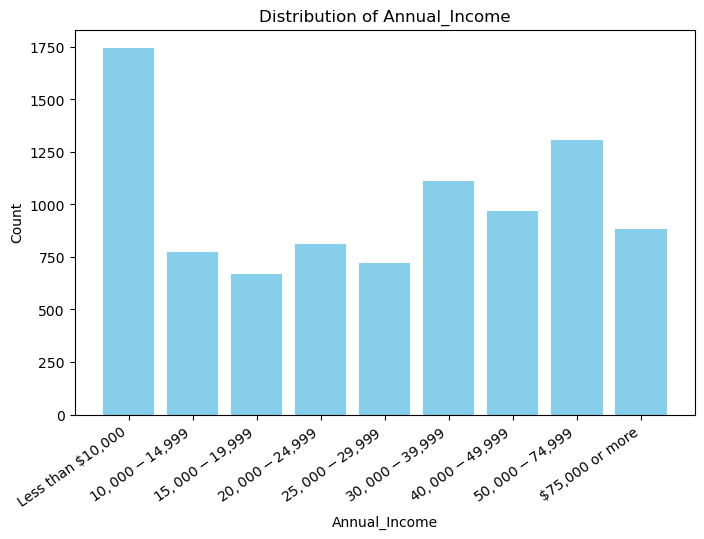

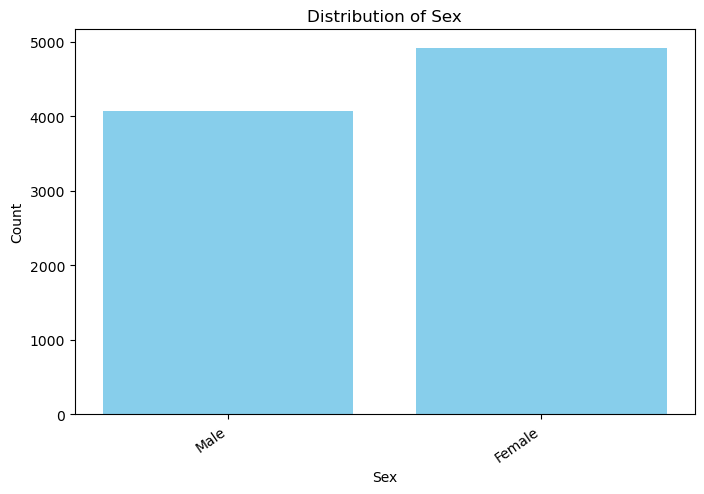

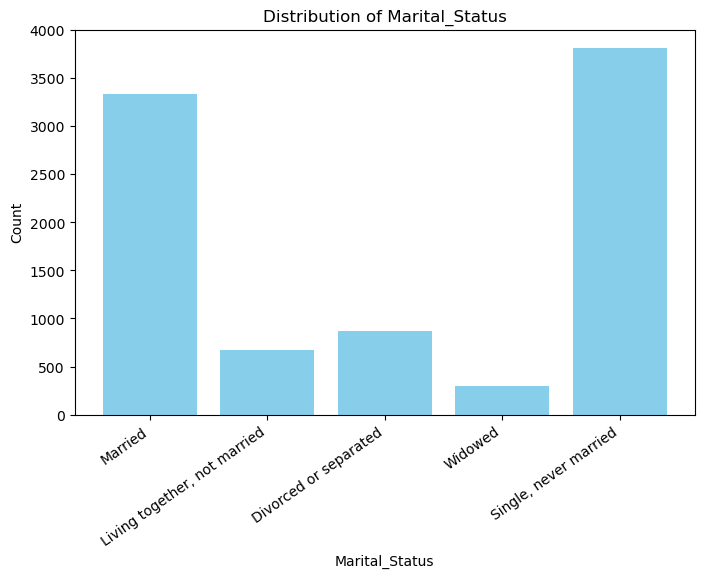

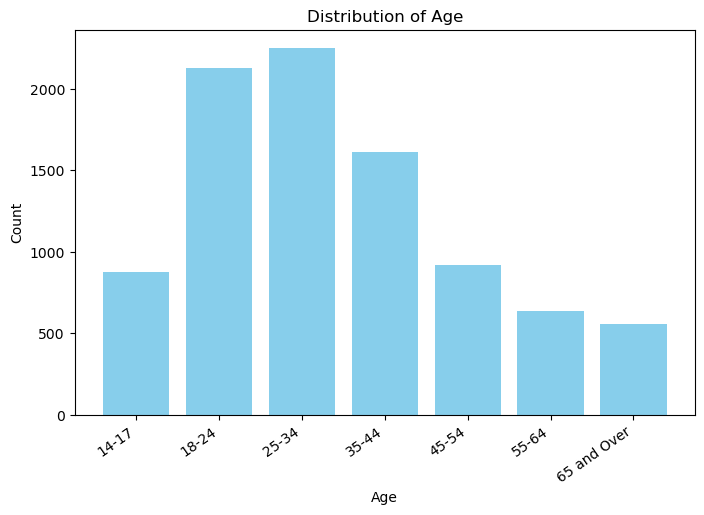

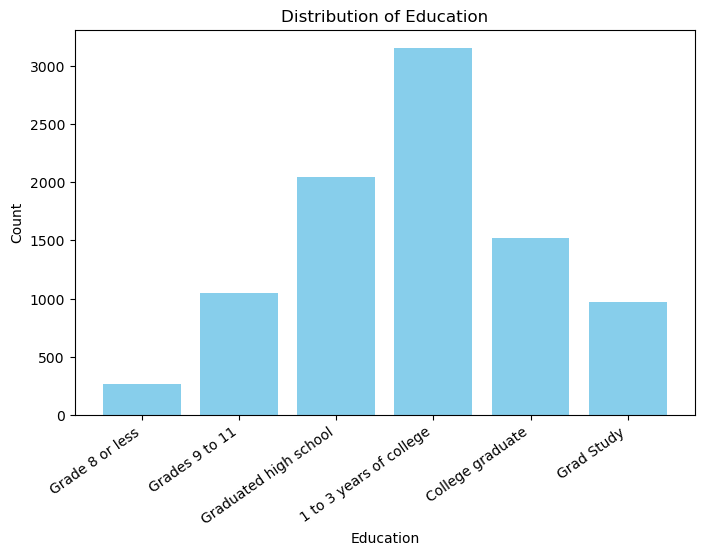

...

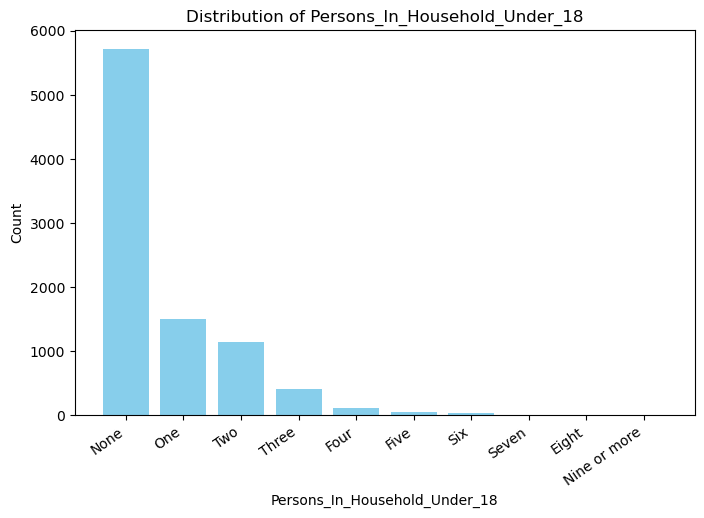

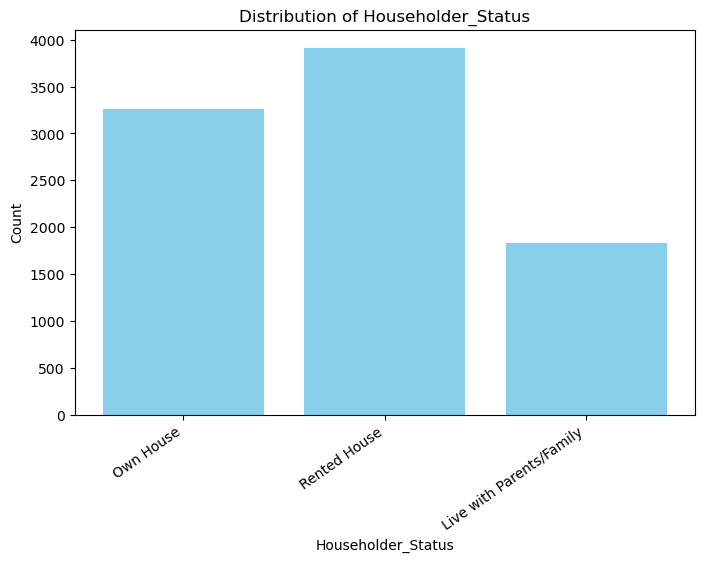

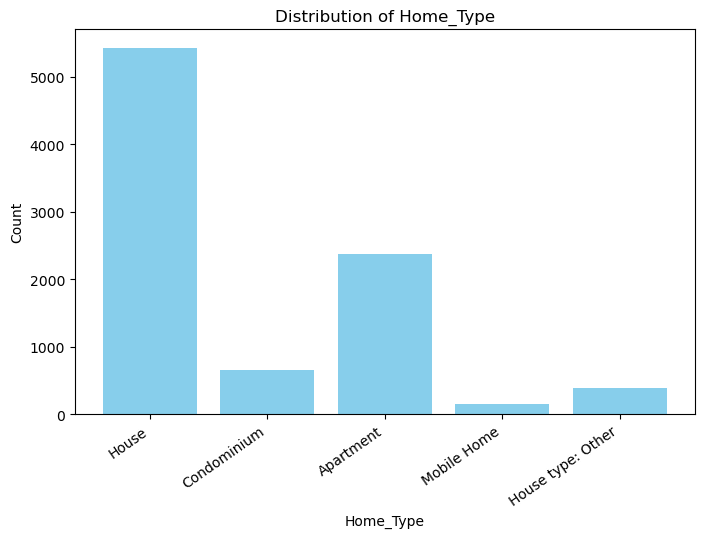

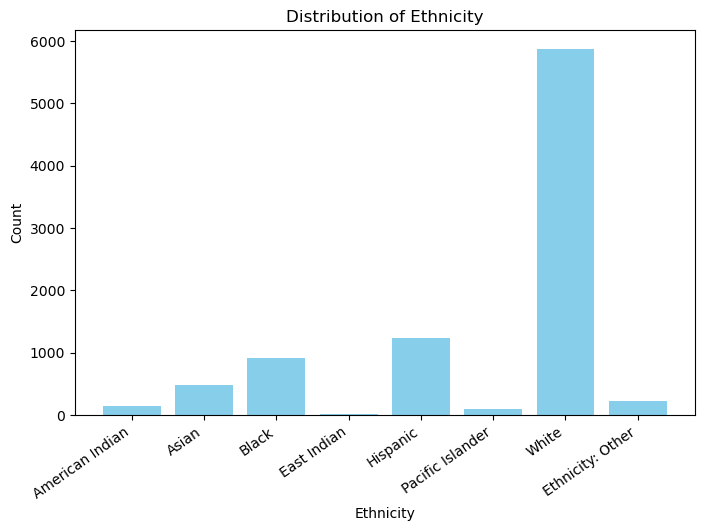

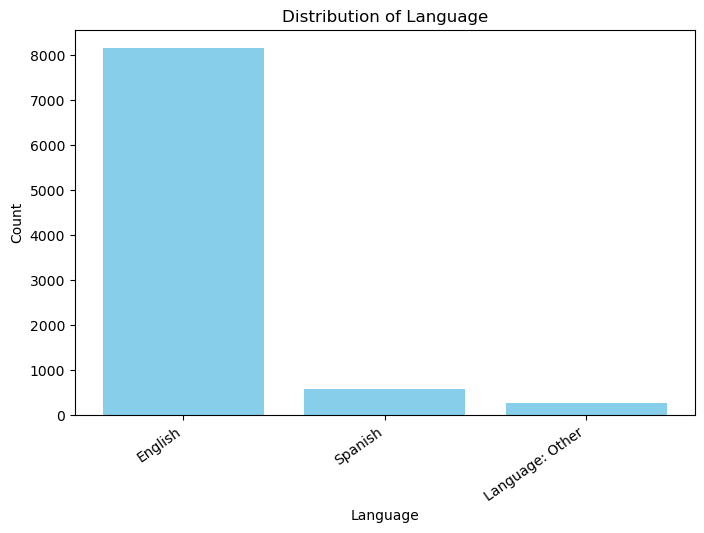

In [11]:
# plots med label

    
# Opret søjlediagrammer for hver kategori med labels
for col in df.columns:
    plt.figure(figsize=(8, 5))
    
    value_counts = df[col].value_counts().sort_index()  # Sorter for at matche labels
    labels = attribute_labels.get(col, list(value_counts.index))  # Brug labels hvis de findes, ellers indeks
    
    plt.bar(labels, value_counts, color='skyblue')
    plt.xlabel(col)
    plt.ylabel("Count")
    plt.title(f"Distribution of {col}")
    plt.xticks(rotation=35, ha="right")
    
    plt.show()


# Boxplot

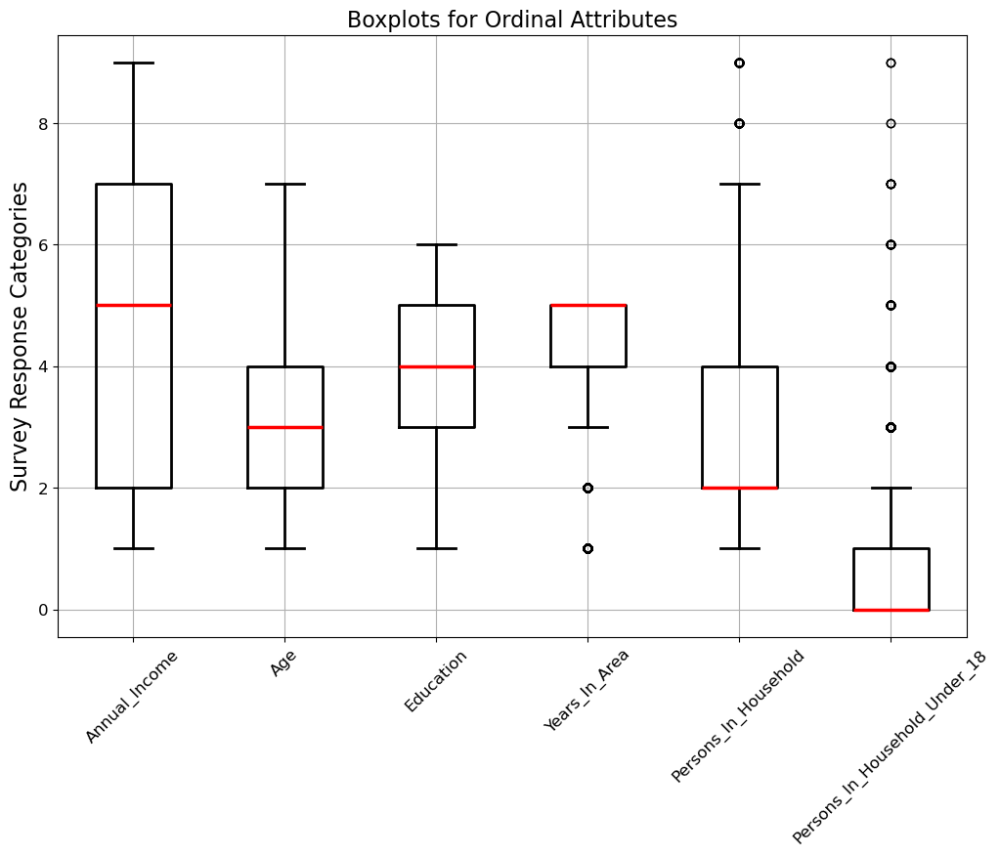

In [12]:
# For ordinale data så standardiserer vi dataen
ordinal_cols = [
    'Annual_Income',  
    'Age',            
    'Education',      
    'Years_In_Area',  
    'Persons_In_Household', 
    'Persons_In_Household_Under_18'        
]

plt.figure(figsize=(12, 8))
df[ordinal_cols].boxplot(rot=45, boxprops={"linewidth": 2}, whiskerprops={"linewidth": 2}, 
                               capprops={"linewidth": 2}, medianprops={"linewidth": 2.5, "color": "red"})
plt.title("Boxplots for Ordinal Attributes", fontsize=16)
plt.ylabel("Survey Response Categories", fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12) 
plt.show()

# 1. Standardisering af ordinale data

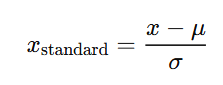

In [13]:
# Standardisering af ordinale data
for col in ordinal_cols:
    print(f"Standardiserer {col}")
    
    # Konverter kolonnen
    numeric_values = df[col].astype(float)
    
    # Beregn middelværdi og standardafvigelse
    mean_val = numeric_values.mean()
    std_val = numeric_values.std(ddof=1)
    
    # Standardiser værdierne
    df[col] = (numeric_values - mean_val) / std_val

Standardiserer Annual_Income
Standardiserer Age
Standardiserer Education
Standardiserer Years_In_Area
Standardiserer Persons_In_Household
Standardiserer Persons_In_Household_Under_18


# One-out-of-K coding på nominale data

In [14]:
# For nominale data så bruger vi One-out-of-K coding
nominal_cols = [
    'Sex',               
    'Marital_Status',    
    'Occupation',        
    'Dual_Incomes',      
    'Householder_Status',
    'Home_Type',         
    'Ethnicity',         
    'Language'           
]

for col in nominal_cols:
    if col in attribute_labels:
        # Lav mapping: 1 -> første label, 2 -> andet label osv.
        mapping = {i+1: label for i, label in enumerate(attribute_labels[col])}
        df[col] = df[col].replace(mapping)

    
# One-out-of-K encoding af nominelle data
df_nominal_list = []
for col in nominal_cols:
    dummies = pd.get_dummies(df[col], prefix='', prefix_sep='')
    df_nominal_list.append(dummies)
df_nominal = pd.concat(df_nominal_list, axis=1)

# Kombiner ordinal og nominal data

In [15]:
# Kombiner standardiserede ordinale data med One-out-of-K encoded nominale data
df_final = pd.concat([df[ordinal_cols], df_nominal], axis=1)
print(df_final.shape)
print(df_final.head())

(8993, 44)
   Annual_Income       Age  Education  Years_In_Area  Persons_In_Household  \
0       1.479965  0.967762   0.132102       0.606708              0.121401   
1       1.479965  0.967762   0.940810       0.606708              1.443139   
2       1.479965 -0.253552   0.940810       0.606708              0.121401   
3      -1.404275 -1.474865  -1.485315       0.606708              0.782270   
4      -1.404275 -1.474865  -1.485315      -1.077800              0.782270   

   Persons_In_Household_Under_18  Female   Male  Divorced or separated  \
0                      -0.615242    True  False                  False   
1                       1.229970   False   True                  False   
2                       0.307364    True  False                  False   
3                       1.229970    True  False                  False   
4                       1.229970    True  False                  False   

   Living together, not married  ...  Asian  Black  East Indian  \
0       

# Beregning af kovariansmatricen

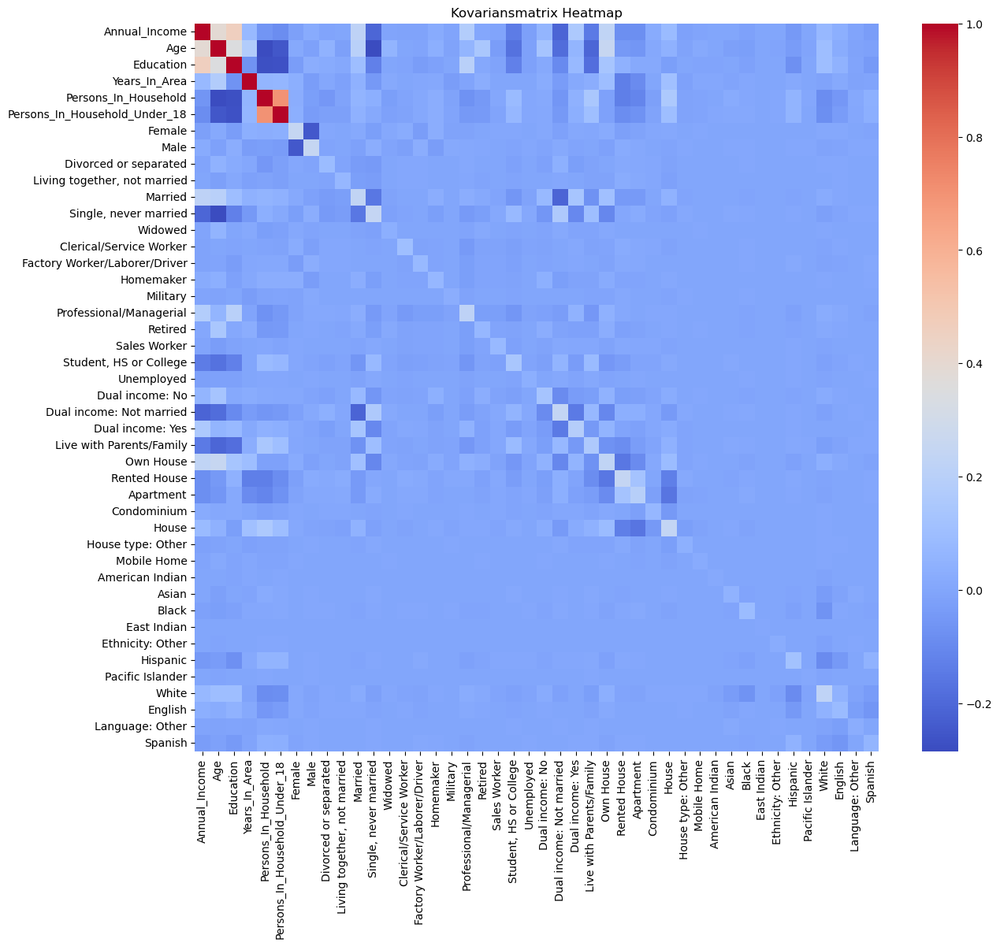

In [16]:
cov_matrix = df_final.cov()
plt.figure(figsize=(14, 12))
sns.heatmap(cov_matrix, cmap="coolwarm", annot=False, yticklabels=True, xticklabels=True)
plt.title("Kovariansmatrix Heatmap")
plt.show()


# Beregning af korrelationsmatricen

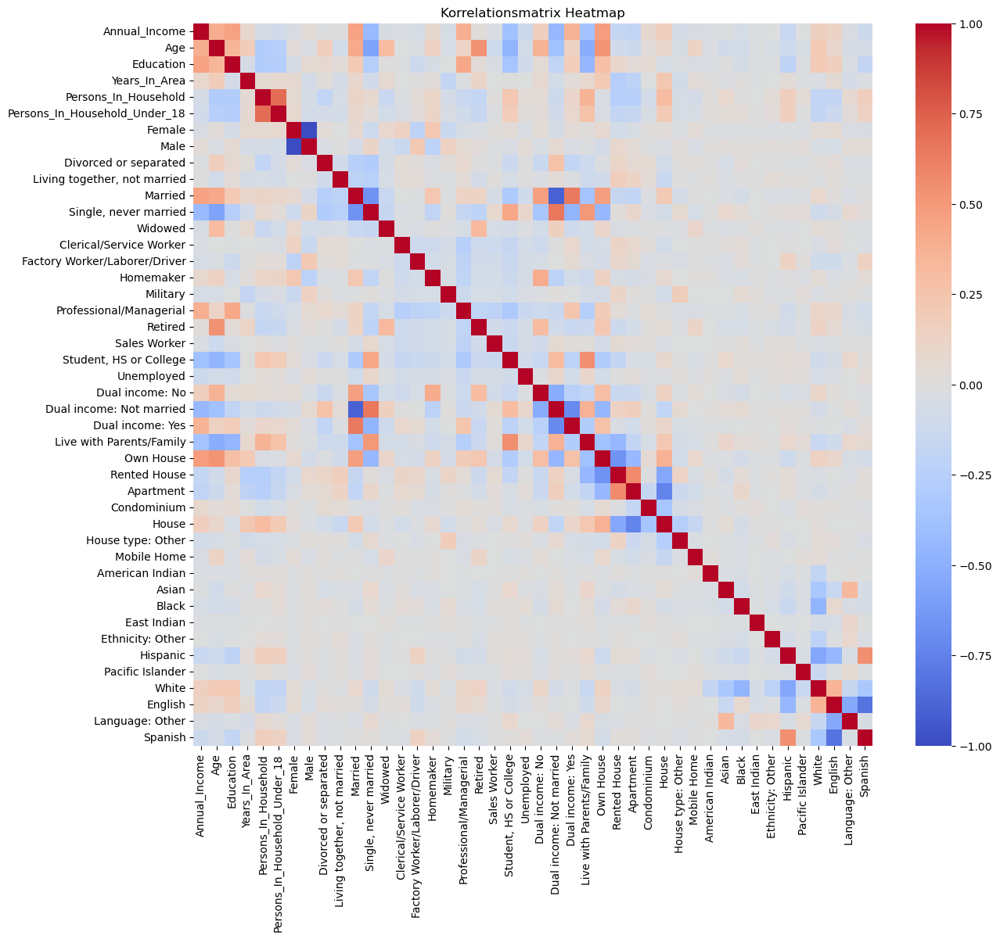

In [17]:
# Beregn korrelationsmatricen
corr_matrix = df_final.corr()

plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, cmap="coolwarm", annot=False, yticklabels=True, xticklabels=True)
plt.title("Korrelationsmatrix Heatmap")
plt.yticks(rotation=0)
plt.show()

 # Udregning af egenværdier og egenvektorer

In [18]:
# # Se korrelationerne mellem 'Annual_Income' og de andre variabler
# income_corr = corr_matrix["Annual_Income"].sort_values(ascending=False)

# # Print resultaterne
# print("Korrelationskoefficienter for Annual_Income:")
# print(income_corr)

# Forklaret varians - Vælg antal hovedkomponenter

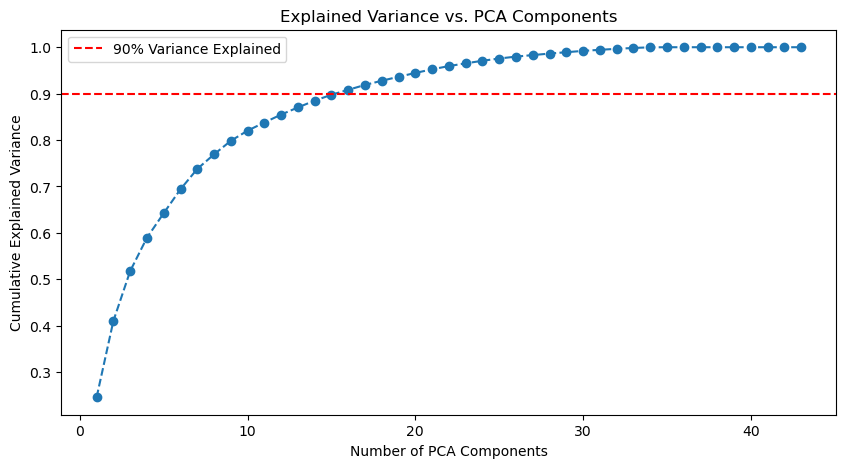

In [19]:
# Explained variance vs PCA Components

# Fjern Annual_Income, da det er vores target
X_pca = df_final.drop(columns=["Annual_Income"])

# PCA med alle komponenter
pca = PCA(n_components=X_pca.shape[1])  # Antal features (44)
X_pca_transformed = pca.fit_transform(X_pca)

# Forklaret varians per komponent
explained_variance = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance)

# Plot varians per komponent
plt.figure(figsize=(10, 5))
plt.plot(range(1, len(explained_variance) + 1), cumulative_variance, marker="o", linestyle="--")
plt.axhline(y=0.90, color="r", linestyle="--", label="90% Variance Explained")
plt.xlabel("Number of PCA Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Explained Variance vs. PCA Components")
plt.legend()
plt.show()

In [20]:
# Vi vælger 16 for at få 90% af variansen

# Kør PCA og find hovedkomponenterne

In [21]:
# Vælg kun de numeriske PCA-inputs (uden one-hot encoding)
X_pca = df_final.drop(columns=["Annual_Income"])  # Fjern Annual_Income
pca = PCA(n_components=16)  # Vi vælger 16 komponenter
X_pca_transformed = pca.fit_transform(X_pca)  # Transform data til PCA-rummet

# Forklaringsgrad af de første komponenter
explained_variance = pca.explained_variance_ratio_
print("Forklaret varians af hver PCA-komponent:\n", explained_variance)


Forklaret varians af hver PCA-komponent:
 [0.2455753  0.1646055  0.10730024 0.07196314 0.05287193 0.05161043
 0.04375111 0.03141316 0.02917655 0.0218935  0.0175691  0.01709442
 0.01538076 0.01470704 0.01260722 0.010749  ]


# Annual_Income projiceres på PCA-rummet

In [22]:
# Omdan PCA-transformationen til DataFrame
pca_df = pd.DataFrame(X_pca_transformed, columns=[f"PC{i+1}" for i in range(16)])

# Tilføj `Annual_Income` tilbage i datasættet
pca_df["Annual_Income"] = df_final["Annual_Income"].values

# Beregn korrelationen mellem `Annual_Income` og de PCA-komponenter
income_pca_corr = pca_df.corr()["Annual_Income"].drop("Annual_Income")

# Udskriv resultatet
print("Korrelation mellem PCA-komponenter og Annual_Income:\n", income_pca_corr)


Korrelation mellem PCA-komponenter og Annual_Income:
 PC1    -0.393360
PC2     0.411538
PC3    -0.229780
PC4     0.132806
PC5     0.044167
PC6    -0.066119
PC7    -0.161495
PC8    -0.053932
PC9    -0.037898
PC10    0.093911
PC11    0.035783
PC12   -0.017886
PC13    0.071068
PC14    0.043960
PC15    0.066437
PC16    0.005659
Name: Annual_Income, dtype: float64


# Visualiser Annual_Income i PCA-rummet

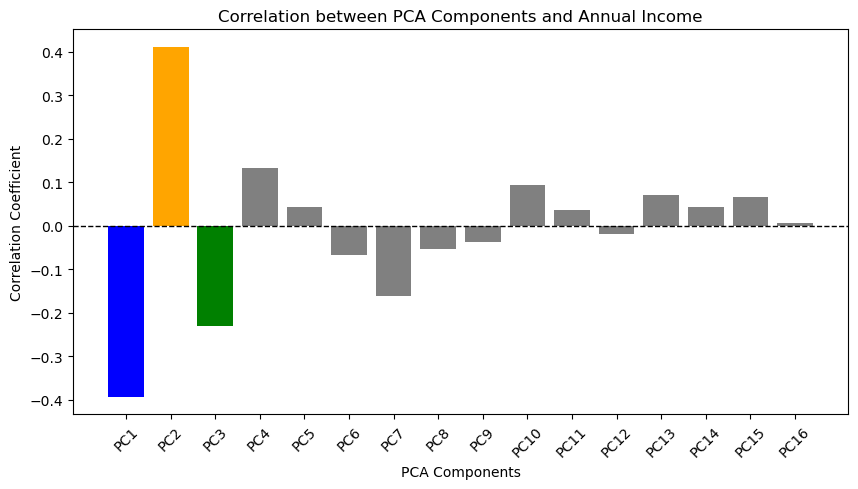

In [23]:
# Partiel help from copilot in this plot:
colors = ['blue' if component == 'PC1' else 'orange' if component == 'PC2' else 'green' if component == 'PC3' else 'gray' for component in income_pca_corr.index]

plt.figure(figsize=(10, 5))
plt.bar(income_pca_corr.index, income_pca_corr.values, color=colors)

plt.axhline(0, color='black', linestyle='dashed', linewidth=1)
plt.xlabel("PCA Components")
plt.ylabel("Correlation Coefficient")
plt.title("Correlation between PCA Components and Annual Income")

plt.xticks(rotation=45)
plt.show()

In [24]:
# Positiv vs. negativ loading

# En positiv loading betyder, at attributten varierer i samme retning som komponenten.
# En negativ loading betyder, at attributten varierer i modsat retning af komponenten.
# Størrelsen af søjlen afspejler, hvor stærk denne sammenhæng er.

# PCA coponent coefficients plot

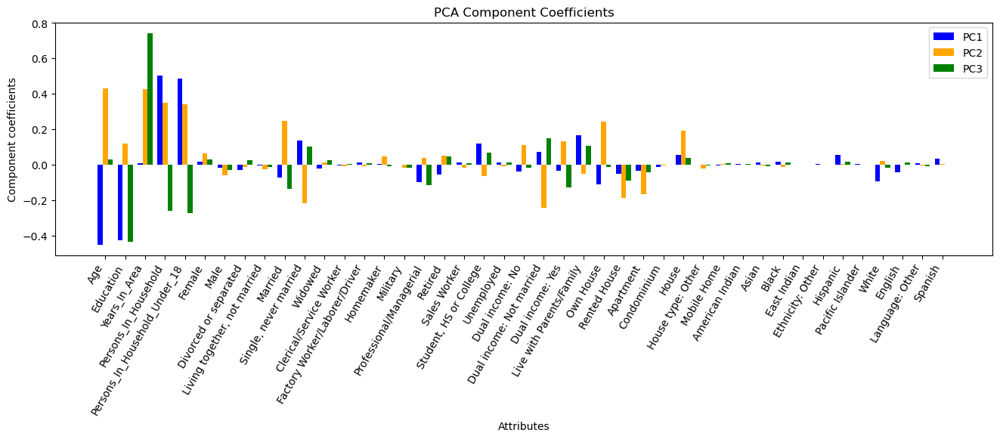

In [25]:
# Kør plottet igen
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

pca_components = pca.components_  # Hent PCA-komponentkoefficienter
attributes = X_pca.columns  # Fjern Annual_Income

# Opret en DataFrame med PCA-komponenter
df_pca = pd.DataFrame(pca_components[:3], columns=attributes, index=["PC1", "PC2", "PC3"]).T  # Kun de første 3 komponenter

# Definer positioner for hver feature
x = np.arange(len(df_pca.index))
width = 0.25  # Bredden af søjlerne

fig, ax = plt.subplots(figsize=(16, 4))


# Tegn søjler for hver PCA-komponent
ax.bar(x - width, df_pca["PC1"], width, label="PC1", color="blue")
ax.bar(x, df_pca["PC2"], width, label="PC2", color="orange")
ax.bar(x + width, df_pca["PC3"], width, label="PC3", color="green")

# Tilpasning af plottet
ax.set_xticks(x)
ax.set_xticklabels(df_pca.index, rotation=90)
ax.set_ylabel("Component coefficients")
ax.set_xlabel("Attributes")
ax.set_title("PCA Component Coefficients")
ax.legend()
plt.xticks(rotation=60, ha="right")

plt.show()


In [26]:
print(df_pca)

                                    PC1       PC2       PC3
Age                           -0.450813  0.431044  0.027109
Education                     -0.428972  0.119053 -0.434358
Years_In_Area                  0.006029  0.423730  0.743452
Persons_In_Household           0.503164  0.347606 -0.260623
Persons_In_Household_Under_18  0.485373  0.340217 -0.274290
Female                         0.017889  0.061449  0.031170
Male                          -0.017889 -0.061449 -0.031170
Divorced or separated         -0.032510 -0.012175  0.023406
Living together, not married  -0.006898 -0.026107 -0.011522
Married                       -0.074818  0.248365 -0.137032
Single, never married          0.135219 -0.220187  0.099540
Widowed                       -0.020993  0.010103  0.025608
Clerical/Service Worker       -0.003135 -0.010219  0.004660
Factory Worker/Laborer/Driver  0.012855 -0.007224  0.009303
Homemaker                      0.003968  0.047795 -0.010217
Military                      -0.002299 

# Annual income correlation plot

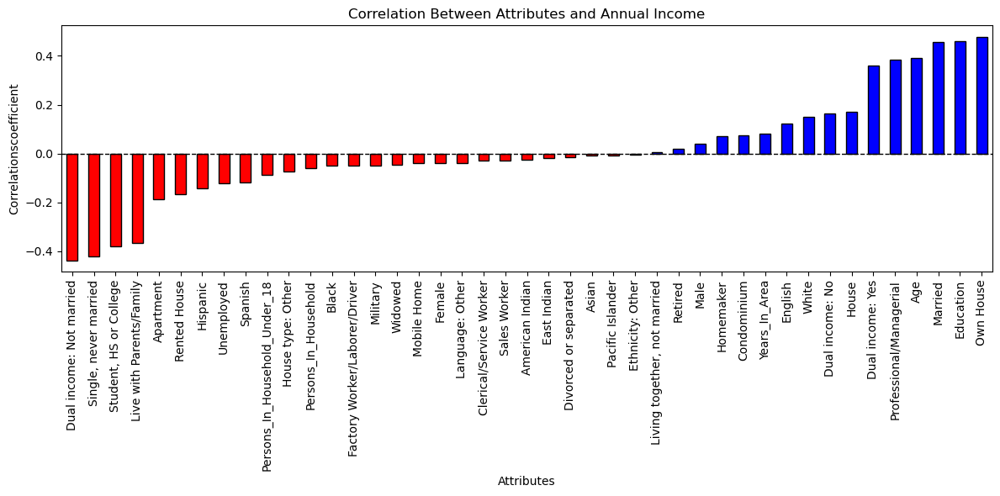

In [27]:
# Beregn korrelationen mellem hver attribut og Annual_Income
attribute_correlations = df_final.drop(columns=["Annual_Income"]).corrwith(df_final["Annual_Income"])

# Sortér korrelationerne i faldende orden
attribute_correlations_sorted = attribute_correlations.sort_values()

# Farvekodning: Blå for positive, rød for negative korrelationer
colors = ['blue' if val > 0 else 'red' for val in attribute_correlations_sorted]

# Plot
plt.figure(figsize=(12, 6))
attribute_correlations_sorted.plot(kind='bar', color=colors, edgecolor='black')

# Tilføj en vandret linje ved 0 for reference
plt.axhline(y=0, color='black', linestyle='--', linewidth=1)

# Tilpasning af labels og titel
plt.xlabel("Attributes")
plt.ylabel("Correlationscoefficient")
plt.title("Correlation Between Attributes and Annual Income")
plt.xticks(rotation=90)
plt.tight_layout()

# Vis plottet
plt.show()

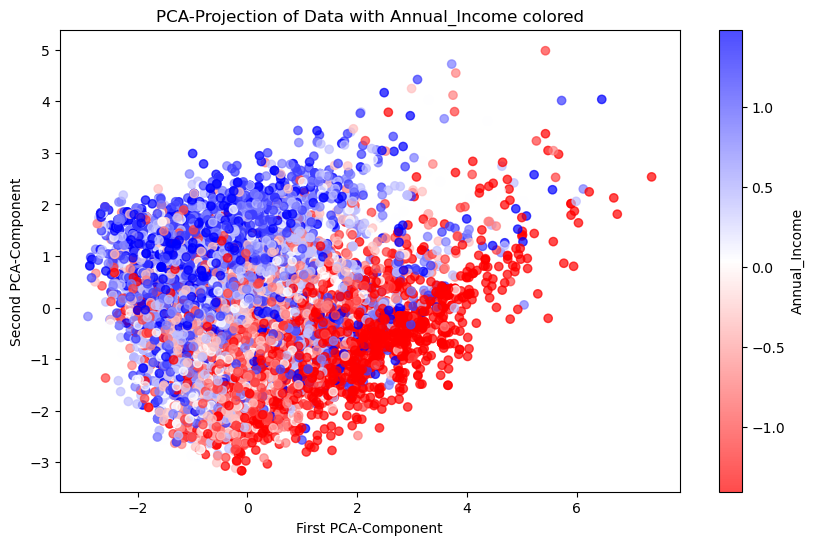

In [28]:
plt.figure(figsize=(10, 6))
plt.scatter(X_pca_transformed[:, 0], X_pca_transformed[:, 1], c=df_final["Annual_Income"], cmap="bwr_r", alpha=0.7)
plt.colorbar(label="Annual_Income")
plt.xlabel("First PCA-Component")
plt.ylabel("Second PCA-Component")
plt.title("PCA-Projection of Data with Annual_Income colored")
plt.show()

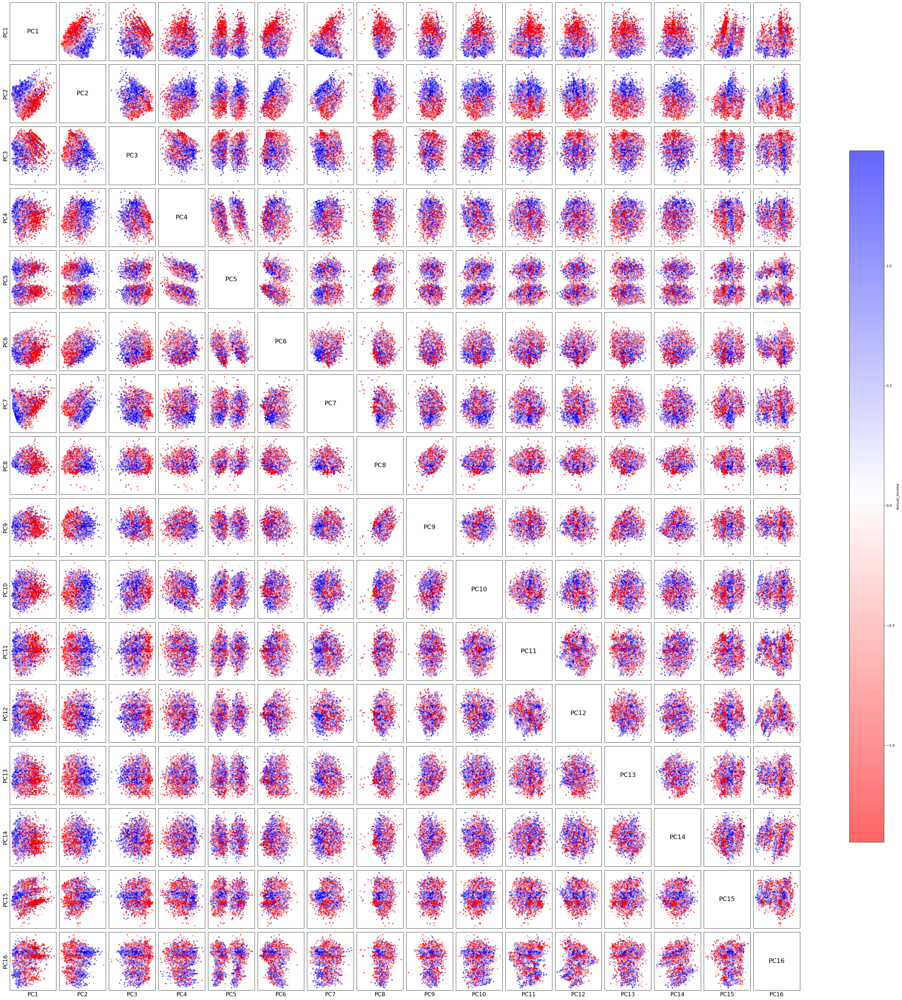

In [29]:
# Antag X_pca_transformed har form (n_samples, n_components)
n_components = X_pca_transformed.shape[1]

fig, axes = plt.subplots(n_components, n_components,
                         figsize=(2.5 * n_components, 2.5 * n_components),
                         sharex=False, sharey=False)

sc = None  # holder reference til scatter-plot, så vi kan lave en colorbar

# Help from copilot:
for i in range(n_components):
    for j in range(n_components):
        ax = axes[i, j]
        if i != j:
            # Plot PCj mod PCi, farvelagt efter Annual_Income
            sc = ax.scatter(X_pca_transformed[:, j],
                            X_pca_transformed[:, i],
                            c=df_final["Annual_Income"],
                            cmap="bwr_r",
                            alpha=0.6,
                            s=10)
        else:
            # På diagonalen: vis komponentnavn
            ax.text(0.5, 0.5, f"PC{i+1}",
                    ha="center", va="center",
                    transform=ax.transAxes,
                    fontsize=18)
        # Fjern typetal for at holde plottet overskueligt
        ax.set_xticks([])
        ax.set_yticks([])

        # Sæt eventuelt akse-labels på de nederste og venstre subplots
        if i == n_components - 1:
            ax.set_xlabel(f"PC{j+1}", fontsize=16)
        if j == 0:
            ax.set_ylabel(f"PC{i+1}", fontsize=16)

plt.tight_layout()

# Tilføj én samlet colorbar til hele figuren
if sc is not None:
    cbar = fig.colorbar(sc, ax=axes.ravel().tolist(), shrink=0.7)
    cbar.set_label("Annual_Income")

plt.show()


# -----Projekt 2-----

In [60]:
# imports:
import numpy as np
import matplotlib.pyplot as plt
import sklearn.linear_model as lm
from sklearn.model_selection import KFold
from dtuimldmtools import bmplot, feature_selector_lr
from sklearn.linear_model import Ridge
from sklearn.neural_network import MLPRegressor
from scipy.stats import t
import pandas as pd

## Map annual income før standardisering: 

In [31]:
# Her har vi annual_income dataen før standarisering:
original_annual_income

# tilføjer til df:
df["Annual_Income_Num"] = original_annual_income
df["Annual_Income_Num"]

0       9
1       9
2       9
3       1
4       1
       ..
8988    1
8989    2
8990    1
8991    4
8992    6
Name: Annual_Income_Num, Length: 8993, dtype: int64

In [ ]:
# Lav annual income om fra ordinal til continous:

income_mapping = {
    1: 5000,
    2: 15000,
    3: 25000,
    4: 35000,
    5: 45000,
    6: 55000,
    7: 65000,
    8: 72500,
    9: 100000 # 75000 or more
}

# Så mapper vi:
df["Annual_Income_Num"] = original_annual_income.map(income_mapping)
df["Annual_Income_Num"]

0       100000
1       100000
2       100000
3         5000
4         5000
         ...  
8988      5000
8989     15000
8990      5000
8991     35000
8992     55000
Name: Annual_Income_Num, Length: 8993, dtype: int64

## Standardiser igen med z-scores

In [ ]:
# ligesom de andre ordinale variable, så standardisere vi 
# igen efter det nu er en kontinuerlig variabel

print(f"Standardiserer Annual_Income_Num")

# Konverter kolonnen
numeric_values = df["Annual_Income_Num"].astype(float)

# Beregn middelværdi og standardafvigelse
mean_val = numeric_values.mean()
std_val = numeric_values.std(ddof=1)
print(f"Mean: {mean_val}, Std: {std_val}")

# Create standardized version
standardized_income = (df["Annual_Income_Num"] - mean_val) / std_val

# fjerner i df_final hvis den allerede er der
if "Annual_Income_Num_Std" in df_final.columns:
    df_final = df_final.drop(columns=["Annual_Income_Num_Std"])
if "Annual_Income" in df_final.columns:
    df_final = df_final.drop(columns=["Annual_Income"])


new_df_final = pd.DataFrame({"Annual_Income": standardized_income})
df_final = pd.concat([new_df_final, df_final], axis=1)

print(df_final.shape)
print(df_final.head())

Standardiserer Annual_Income_Num
Mean: 45061.15867897253, Std: 29826.45787335789
(8993, 44)
   Annual_Income       Age  Education  Years_In_Area  Persons_In_Household  \
0       1.841950  0.967762   0.132102       0.606708              0.121401   
1       1.841950  0.967762   0.940810       0.606708              1.443139   
2       1.841950 -0.253552   0.940810       0.606708              0.121401   
3      -1.343142 -1.474865  -1.485315       0.606708              0.782270   
4      -1.343142 -1.474865  -1.485315      -1.077800              0.782270   

   Persons_In_Household_Under_18  Female   Male  Divorced or separated  \
0                      -0.615242    True  False                  False   
1                       1.229970   False   True                  False   
2                       0.307364    True  False                  False   
3                       1.229970    True  False                  False   
4                       1.229970    True  False                  Fals

### Nu er dataen klar da vi har gjort annual_income continous, så kan vi påbegynde vores modeller:

# Regression, part a

Hele Part a handler kun om linear regressions, hvor vi laver 3 forskellige former, en hel normal, en med feature selection (vi bruger forward), og en hvor vi introducere en regularization strenght (lambda)

In [ ]:
X = df_final.drop(columns=["Annual_Income"]).values
y = df_final['Annual_Income'].values

attributeNames = list(df_final.drop(columns=["Annual_Income"]).columns)

# prnter det hele
print('X shape:', X.shape)
print('y shape:', y.shape)
print('Number of attributes:', len(attributeNames))

X shape: (8993, 43)
y shape: (8993,)
Number of attributes: 43


### Så laver vi to modeller en hvor der er ingen feature selection og en hvor der er en feature selection ved brug af forward selection og sammenligner de to:

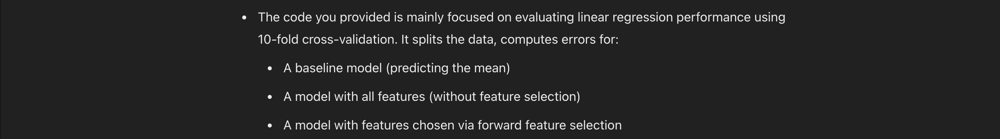


Fold 1/10

Fold 2/10

Fold 3/10

Fold 4/10

Fold 5/10

Fold 6/10

Fold 7/10

Fold 8/10

Fold 9/10

Fold 10/10

LINEAR REGRESSION WITHOUT FEATURE SELECTION
Train error: 0.54
Test error:  0.55

LINEAR REGRESSION WITH FEATURE SELECTION
Train error: 0.55
Test error:  0.55

R^2 train: 0.45
R^2 test:  0.45


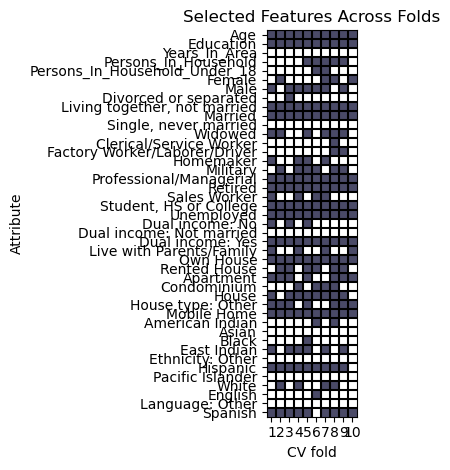

In [ ]:
K = 10  # Ydre CV
CV = KFold(n_splits=K, shuffle=True)

M = X.shape[1]  # antal features
Features = np.zeros((M, K))
Error_train = np.empty((K, 1))
Error_test = np.empty((K, 1))
Error_train_fs = np.empty((K, 1))
Error_test_fs = np.empty((K, 1))
Error_train_nofeatures = np.empty((K, 1))
Error_test_nofeatures = np.empty((K, 1))

k = 0
for train_index, test_index in CV.split(X):
    print(f"\nFold {k + 1}/{K}")

    # Splitter data:
    X_train = X[train_index]
    y_train = y[train_index]
    X_test = X[test_index]
    y_test = y[test_index]

    internal_cv = 10  

    # Baseline 
    Error_train_nofeatures[k] = np.mean((y_train - np.mean(y_train)) ** 2)
    Error_test_nofeatures[k] = np.mean((y_test - np.mean(y_train)) ** 2)

    # Alle features (ingen feature selection)
    model_all = lm.LinearRegression().fit(X_train, y_train)
    Error_train[k] = np.mean((y_train - model_all.predict(X_train)) ** 2)
    Error_test[k] = np.mean((y_test - model_all.predict(X_test)) ** 2)

    # Forward feature selection:
    selected_features, features_record, loss_record = feature_selector_lr(
        X_train, y_train, internal_cv, display=False
    )

    if len(selected_features) == 0:
        print("No features were selected.")
    else:
        Features[selected_features, k] = 1
        model_fs = lm.LinearRegression().fit(X_train[:, selected_features], y_train)
        Error_train_fs[k] = np.mean((y_train - model_fs.predict(X_train[:, selected_features])) ** 2)
        Error_test_fs[k] = np.mean((y_test - model_fs.predict(X_test[:, selected_features])) ** 2)

    k += 1

# Resultater
print("\nLINEAR REGRESSION WITHOUT FEATURE SELECTION")
print(f"Train error: {Error_train.mean():.2f}")
print(f"Test error:  {Error_test.mean():.2f}")

print("\nLINEAR REGRESSION WITH FEATURE SELECTION")
print(f"Train error: {Error_train_fs.mean():.2f}")
print(f"Test error:  {Error_test_fs.mean():.2f}")

# R^2
print(f"\nR^2 train: {(Error_train_nofeatures.sum() - Error_train_fs.sum()) / Error_train_nofeatures.sum():.2f}")
print(f"R^2 test:  {(Error_test_nofeatures.sum() - Error_test_fs.sum()) / Error_test_nofeatures.sum():.2f}")

# Plot: hvilke features blev valgt i hvilke fold
plt.figure()
bmplot(attributeNames, range(1, K + 1), -Features)
plt.xlabel("CV fold")
plt.ylabel("Attribute")
plt.title("Selected Features Across Folds")
plt.clim(-1.5, 0)
plt.tight_layout()
plt.show()


Hvofor er der så lidt forskel på modelperformance på den med og uden feature selection?   
   
    
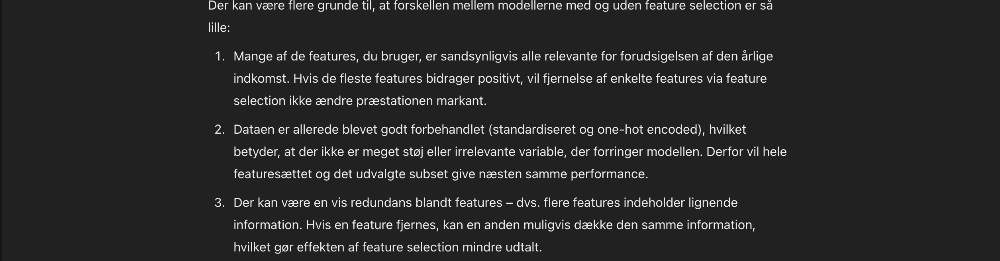

### Så tilføjer vi regularization strenght (lambda) for at undgå overfitting:

Optimal lambda (alpha): 23.95026619987486
Minimum CV Error (MSE): 0.5484157490008265


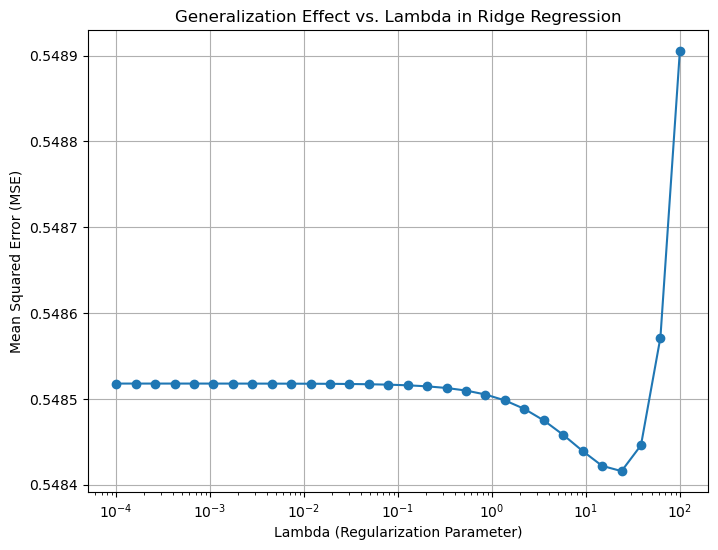

In [63]:
K = 10
kf = KFold(n_splits=K, shuffle=True, random_state=42)


lambdas = np.logspace(-4, 2, 30) 
cv_errors = []

# Krydsvalidering for hver λ-værdi:
for lam in lambdas:
    fold_errors = []  
    for train_index, test_index in kf.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        
        model = Ridge(alpha=lam)
        model.fit(X_train, y_train)
        
        y_pred = model.predict(X_test)
        mse = np.mean((y_test - y_pred) ** 2)
        fold_errors.append(mse)
    
    avg_mse = np.mean(fold_errors)
    cv_errors.append(avg_mse)


cv_errors = np.array(cv_errors)

# Finder den lambda-værdi, der giver den laveste gennemsnitlige MSE:
optimal_lambda = lambdas[np.argmin(cv_errors)]
print("Optimal lambda (alpha):", optimal_lambda)
print("Minimum CV Error (MSE):", np.min(cv_errors))

# Plot the results
plt.figure(figsize=(8, 6))
plt.semilogx(lambdas, cv_errors, marker='o', linestyle='-')
plt.xlabel("Lambda (Regularization Parameter)")
plt.ylabel("Mean Squared Error (MSE)")
plt.title("Generalization Effect vs. Lambda in Ridge Regression")
plt.grid(True)
plt.show()

In [ ]:
# Vi vil bruge den lambda hvor MSE (fejl) er lavest, og det er den ved 23.95 som ses på plottet

# Regression, part b

In this section, we will compare three models: the regularized linear regression
model from the previous section, an artificial neural network (ANN) and a baseline. We
are interested in two questions: Is one model better than the other? Is either model better than
a trivial baseline?. We will attempt to answer these questions with two-level cross-validation.

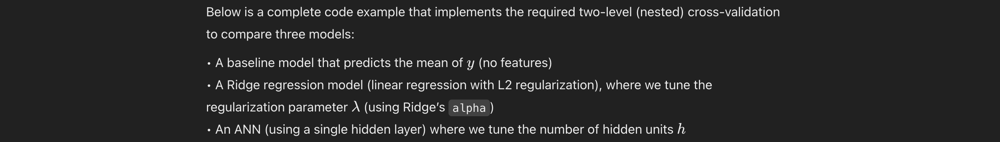

Completed outer fold 1
Completed outer fold 2
Completed outer fold 3
Completed outer fold 4
Completed outer fold 5
Completed outer fold 6
Completed outer fold 7
Completed outer fold 8
Completed outer fold 9
Completed outer fold 10

Nested CV Results:
   baseline_error  best_ridge_lambda  ridge_error  best_ann_hidden  ann_error
0        0.984733          21.544347     0.529582                3   0.492597
1        1.013784           4.641589     0.510686                3   0.500908
2        1.010925          21.544347     0.544566                5   0.506085
3        0.998782          21.544347     0.581200                5   0.563774
4        0.983497          21.544347     0.570443                5   0.564417
5        0.967072          21.544347     0.566935                5   0.519073
6        1.004004          21.544347     0.575865                5   0.549438
7        1.036095          21.544347     0.505044               10   0.499483
8        0.983851          21.544347     0.5408

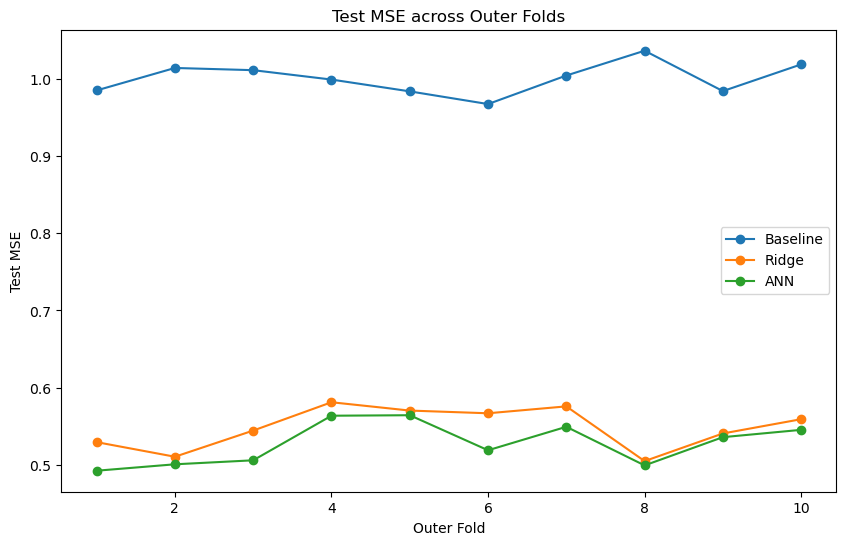

In [ ]:
K_outer = 10  
outer_cv = KFold(n_splits=K_outer, shuffle=True, random_state=42)

K_inner = 10  


lambdas = np.logspace(-4, 2, 10) 
hidden_units_range = [1, 3, 5, 10, 20]
results = []  

# påbegyndelsen af outer loop:
fold = 1
for outer_train_idx, outer_test_idx in outer_cv.split(X):
    X_train_outer = X[outer_train_idx]
    y_train_outer = y[outer_train_idx]
    X_test_outer = X[outer_test_idx]
    y_test_outer = y[outer_test_idx]
    
    baseline_prediction = np.mean(y_train_outer)
    baseline_error = np.mean((y_test_outer - baseline_prediction) ** 2)
    
    best_ridge_lambda = None
    best_ridge_inner_error = np.inf  
    
    inner_cv = KFold(n_splits=K_inner, shuffle=True, random_state=42)

    # påbegyndelsen af inner loop:
    for lam in lambdas:
        inner_errors = []
        for inner_train_idx, inner_val_idx in inner_cv.split(X_train_outer):
            X_train_inner = X_train_outer[inner_train_idx]
            y_train_inner = y_train_outer[inner_train_idx]
            X_val_inner = X_train_outer[inner_val_idx]
            y_val_inner = y_train_outer[inner_val_idx]

            model = Ridge(alpha=lam, random_state=42)
            model.fit(X_train_inner, y_train_inner)
            y_val_pred = model.predict(X_val_inner)
            mse = np.mean((y_val_inner - y_val_pred) ** 2)
            inner_errors.append(mse)
        avg_inner_error = np.mean(inner_errors)
        if avg_inner_error < best_ridge_inner_error:
            best_ridge_inner_error = avg_inner_error
            best_ridge_lambda = lam
    
 
    final_ridge = Ridge(alpha=best_ridge_lambda, random_state=42)
    final_ridge.fit(X_train_outer, y_train_outer)
    ridge_error = np.mean((y_test_outer - final_ridge.predict(X_test_outer)) ** 2)
    
    # ANN model selektion:
    best_ann_hidden = None
    best_ann_inner_error = np.inf
    
    for h in hidden_units_range:
        inner_errors = []
        for inner_train_idx, inner_val_idx in inner_cv.split(X_train_outer):
            X_train_inner = X_train_outer[inner_train_idx]
            y_train_inner = y_train_outer[inner_train_idx]
            X_val_inner = X_train_outer[inner_val_idx]
            y_val_inner = y_train_outer[inner_val_idx]
            
            ann_model = MLPRegressor(hidden_layer_sizes=(h,), max_iter=1000, random_state=42)
            ann_model.fit(X_train_inner, y_train_inner)
            y_val_pred = ann_model.predict(X_val_inner)
            mse = np.mean((y_val_inner - y_val_pred) ** 2)
            inner_errors.append(mse)
        avg_inner_error = np.mean(inner_errors)
        if avg_inner_error < best_ann_inner_error:
            best_ann_inner_error = avg_inner_error
            best_ann_hidden = h
    
    # Træner det endelige ANN-model med de bedste hyperparametre:
    final_ann = MLPRegressor(hidden_layer_sizes=(best_ann_hidden,), max_iter=1000, random_state=42)
    final_ann.fit(X_train_outer, y_train_outer)
    ann_error = np.mean((y_test_outer - final_ann.predict(X_test_outer)) ** 2)
    
    results.append({
        'baseline_error': baseline_error,
        'best_ridge_lambda': best_ridge_lambda,
        'ridge_error': ridge_error,
        'best_ann_hidden': best_ann_hidden,
        'ann_error': ann_error
    })
    
    print(f"Completed outer fold {fold}")
    fold += 1

results_df = pd.DataFrame(results)
print("\nNested CV Results:")
print(results_df)

print("\nAverage Test Errors:")
print("Baseline:", results_df['baseline_error'].mean())
print("Ridge:", results_df['ridge_error'].mean())
print("ANN:", results_df['ann_error'].mean())

# plotter det hele:
plt.figure(figsize=(10, 6))
plt.plot(results_df.index + 1, results_df['baseline_error'], 'o-', label='Baseline')
plt.plot(results_df.index + 1, results_df['ridge_error'], 'o-', label='Ridge')
plt.plot(results_df.index + 1, results_df['ann_error'], 'o-', label='ANN')
plt.xlabel("Outer Fold")
plt.ylabel("Test MSE")
plt.title("Test MSE across Outer Folds")
plt.legend()
plt.show()


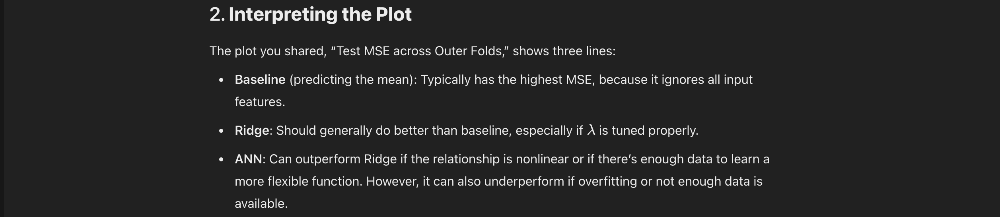

Vi skal ifølge opgaven lave en model ud fra alt ovenstående data  
Her er dataen, der skal så bare sættes flot op:

In [ ]:
# Laver en resultattabel:

results_df = pd.DataFrame({
    'Outer Fold': range(1, len(results) + 1),
    'h*': [res['best_ann_hidden'] for res in results],
    'E_test(ANN)': [res['ann_error'] for res in results],
    'lambda*': [res['best_ridge_lambda'] for res in results],
    'E_test(Ridge)': [res['ridge_error'] for res in results],
    'E_test(Baseline)': [res['baseline_error'] for res in results]
})

print(results_df)

   Outer Fold  h*  E_test(ANN)    lambda*  E_test(Ridge)  E_test(Baseline)
0           1   3     0.492597  21.544347       0.529582          0.984733
1           2   3     0.500908   4.641589       0.510686          1.013784
2           3   5     0.506085  21.544347       0.544566          1.010925
3           4   5     0.563774  21.544347       0.581200          0.998782
4           5   5     0.564417  21.544347       0.570443          0.983497
5           6   5     0.519073  21.544347       0.566935          0.967072
6           7   5     0.549438  21.544347       0.575865          1.004004
7           8  10     0.499483  21.544347       0.505044          1.036095
8           9  10     0.536023  21.544347       0.540809          0.983851
9          10   3     0.545492   4.641589       0.559269          1.018421


In [ ]:
# laver en liste med fejlene:
ann_errors = results_df['E_test(ANN)'].tolist()
ridge_errors = results_df['E_test(Ridge)'].tolist()
baseline_errors = results_df['E_test(Baseline)'].tolist()

print("ANN errors:", ann_errors)
print("Ridge errors:", ridge_errors)
print("Baseline errors:", baseline_errors)

ANN errors: [0.49259704715044333, 0.5009082661155326, 0.5060846465610628, 0.5637735131581509, 0.5644172241709754, 0.5190730203560554, 0.549438038211539, 0.4994833945019489, 0.5360234173697651, 0.5454920525072757]
Ridge errors: [0.5295818484763622, 0.5106864648326526, 0.5445659294386875, 0.5811999930154705, 0.5704427685029239, 0.5669346037554744, 0.5758647322090671, 0.5050437369156132, 0.5408090511340057, 0.559269071880681]
Baseline errors: [0.9847331035564193, 1.0137842881989951, 1.0109252842203225, 0.9987824297074772, 0.9834969180598648, 0.9670719942354261, 1.0040036125079654, 1.0360947230061215, 0.9838505650923163, 1.0184207777600667]


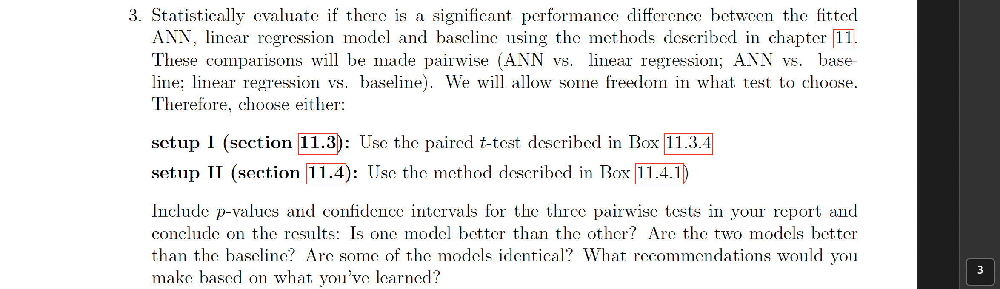

Nu skal vi se om der er statistisk forskel på de 3 modeller  
Vi vælger setup 1, altså paired t-test, why ?? :    

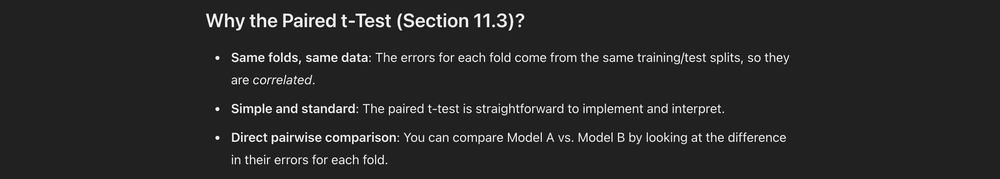

In [ ]:
# kode til parret t-test
def paired_ttest(model1, model2, alpha=0.05):
    model1, model2 = np.array(model1), np.array(model2)
    d = model1 - model2
    K = len(d)
    d_mean = np.mean(d)
    d_std = np.std(d, ddof=1)
    t_stat = d_mean / (d_std / np.sqrt(K))
    df = K - 1
    p_val = 2 * (1 - t.cdf(abs(t_stat), df))
    t_crit = t.ppf(1 - alpha/2, df)
    margin = t_crit * (d_std / np.sqrt(K))
    ci = (d_mean - margin, d_mean + margin)

    return t_stat, p_val, ci

In [ ]:
t_stat, p_val, ci = paired_ttest(ann_errors, ridge_errors, alpha=0.05)
print("\nPaired t-test for Ann vs Linear regression:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")

t_stat, p_val, ci = paired_ttest(ann_errors, baseline_errors, alpha=0.05)
print("\nPaired t-test for Ann vs Baseline:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")

t_stat, p_val, ci = paired_ttest(ridge_errors,baseline_errors, alpha=0.05)
print("\nPaired t-test for Linear regression vs Baseline:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")


Paired t-test for Ann vs Linear regression:
t-statistic: -4.163
p-value:     0.00243730
95% CI:      [-0.032, -0.009]

Paired t-test for Ann vs Baseline:
t-statistic: -39.363
p-value:     0.00000000
95% CI:      [-0.500, -0.445]

Paired t-test for Linear regression vs Baseline:
t-statistic: -34.794
p-value:     0.00000000
95% CI:      [-0.481, -0.422]


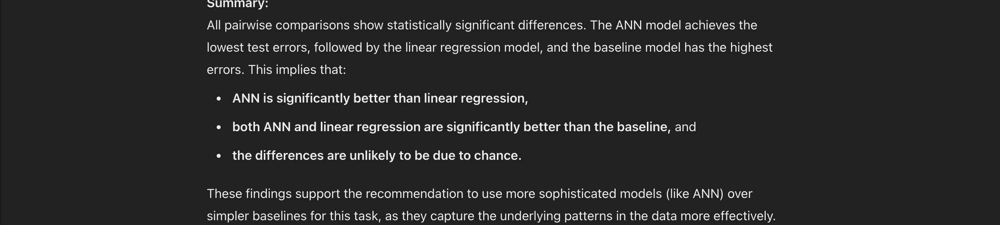

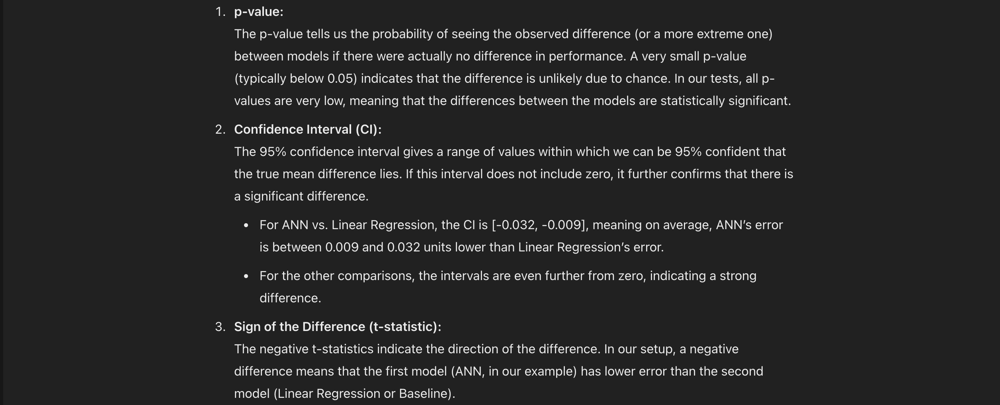

# Classification

Gør præcis det samme som regression part b, bare hvor ANN er udskiftet med et Classification Tree

Completed outer fold 1
Completed outer fold 2
Completed outer fold 3
Completed outer fold 4
Completed outer fold 5
Completed outer fold 6
Completed outer fold 7
Completed outer fold 8
Completed outer fold 9
Completed outer fold 10
Classification Nested CV Results:
   fold  baseline_error  best_logreg_lambda  logreg_error  best_knn_k  \
0     1        0.808889            4.641589      0.653333           9   
1     2        0.777778            0.000100      0.650000           9   
2     3        0.810000            4.641589      0.648889           9   
3     4        0.820912           21.544347      0.668521           9   
4     5        0.814238           21.544347      0.699666           9   
5     6        0.815350            0.215443      0.666296           9   
6     7        0.789766            1.000000      0.648498           9   
7     8        0.800890            0.002154      0.640712           9   
8     9        0.825362            1.000000      0.687430           9   
9    

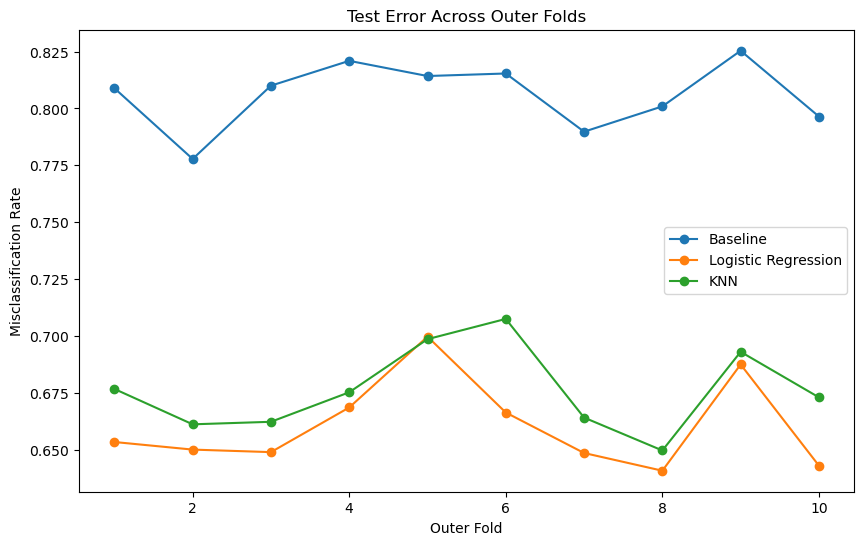

In [ ]:
unique_vals = np.unique(y)
mapping = {val: idx for idx, val in enumerate(sorted(unique_vals))}
y_class = np.array([mapping[val] for val in y])


K_outer = 10  
outer_cv = KFold(n_splits=K_outer, shuffle=True, random_state=42)
K_inner = 10 


lambdas = np.logspace(-4, 2, 10)  
neighbors_range = [1, 3, 5, 7, 9]


results_classification = []

fold = 1
# påbegyndelsen af outer loop:
for outer_train_idx, outer_test_idx in outer_cv.split(X):
    X_train_outer = X[outer_train_idx]
    X_test_outer = X[outer_test_idx]
    y_train_outer = y_class[outer_train_idx]
    y_test_outer = y_class[outer_test_idx]
    
    unique_labels, counts = np.unique(y_train_outer, return_counts=True)
    baseline_class = unique_labels[np.argmax(counts)]
    baseline_preds = np.full(y_test_outer.shape, baseline_class)
    baseline_error = np.mean(baseline_preds != y_test_outer)
    
    best_logreg_lambda = None
    best_logreg_inner_error = np.inf  
    inner_cv = KFold(n_splits=K_inner, shuffle=True, random_state=42)
    
    # påbegyndelsen af inner loop:
    for lam in lambdas:
        inner_errors = []
        for inner_train_idx, inner_val_idx in inner_cv.split(X_train_outer):
            X_train_inner = X_train_outer[inner_train_idx]
            y_train_inner = y_train_outer[inner_train_idx]
            X_val_inner = X_train_outer[inner_val_idx]
            y_val_inner = y_train_outer[inner_val_idx]
            
            C = 1.0 / lam
            logreg = LogisticRegression(C=C, penalty='l2', solver='liblinear', random_state=42)
            logreg.fit(X_train_inner, y_train_inner)
            preds = logreg.predict(X_val_inner)
            error = np.mean(preds != y_val_inner)
            inner_errors.append(error)
        avg_inner_error = np.mean(inner_errors)
        if avg_inner_error < best_logreg_inner_error:
            best_logreg_inner_error = avg_inner_error
            best_logreg_lambda = lam
            
    C_final = 1.0 / best_logreg_lambda
    final_logreg = LogisticRegression(C=C_final, penalty='l2', solver='liblinear', random_state=42)
    final_logreg.fit(X_train_outer, y_train_outer)
    logreg_preds = final_logreg.predict(X_test_outer)
    logreg_error = np.mean(logreg_preds != y_test_outer)
    
    best_knn_k = None
    best_knn_inner_error = np.inf
    
    # KNN model selektion:
    for k_val in neighbors_range:
        inner_errors = []
        for inner_train_idx, inner_val_idx in inner_cv.split(X_train_outer):
            X_train_inner = X_train_outer[inner_train_idx]
            y_train_inner = y_train_outer[inner_train_idx]
            X_val_inner = X_train_outer[inner_val_idx]
            y_val_inner = y_train_outer[inner_val_idx]
            
            knn = KNeighborsClassifier(n_neighbors=k_val)
            knn.fit(X_train_inner, y_train_inner)
            preds = knn.predict(X_val_inner)
            error = np.mean(preds != y_val_inner)
            inner_errors.append(error)
        avg_inner_error = np.mean(inner_errors)
        if avg_inner_error < best_knn_inner_error:
            best_knn_inner_error = avg_inner_error
            best_knn_k = k_val
            
    final_knn = KNeighborsClassifier(n_neighbors=best_knn_k)
    final_knn.fit(X_train_outer, y_train_outer)
    knn_preds = final_knn.predict(X_test_outer)
    knn_error = np.mean(knn_preds != y_test_outer)
    
    results_classification.append({
        'fold': fold,
        'baseline_error': baseline_error,
        'best_logreg_lambda': best_logreg_lambda,
        'logreg_error': logreg_error,
        'best_knn_k': best_knn_k,
        'knn_error': knn_error
    })
    
    print(f"Completed outer fold {fold}")
    fold += 1

results_df_class = pd.DataFrame(results_classification)
print("Classification Nested CV Results:")
print(results_df_class)

print("\nAverage Test Errors:")
print("Baseline:", results_df_class['baseline_error'].mean())
print("Logistic Regression:", results_df_class['logreg_error'].mean())
print("KNN:", results_df_class['knn_error'].mean())

# Plotter resultaterne:
plt.figure(figsize=(10, 6))
plt.plot(results_df_class['fold'], results_df_class['baseline_error'], 'o-', label='Baseline')
plt.plot(results_df_class['fold'], results_df_class['logreg_error'], 'o-', label='Logistic Regression')
plt.plot(results_df_class['fold'], results_df_class['knn_error'], 'o-', label='KNN')
plt.xlabel("Outer Fold")
plt.ylabel("Misclassification Rate")
plt.title("Test Error Across Outer Folds")
plt.legend()
plt.show()


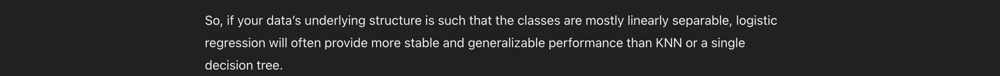

# Hvorfor perfomer linear regression bedre end både KNN og Classification Tree ?    
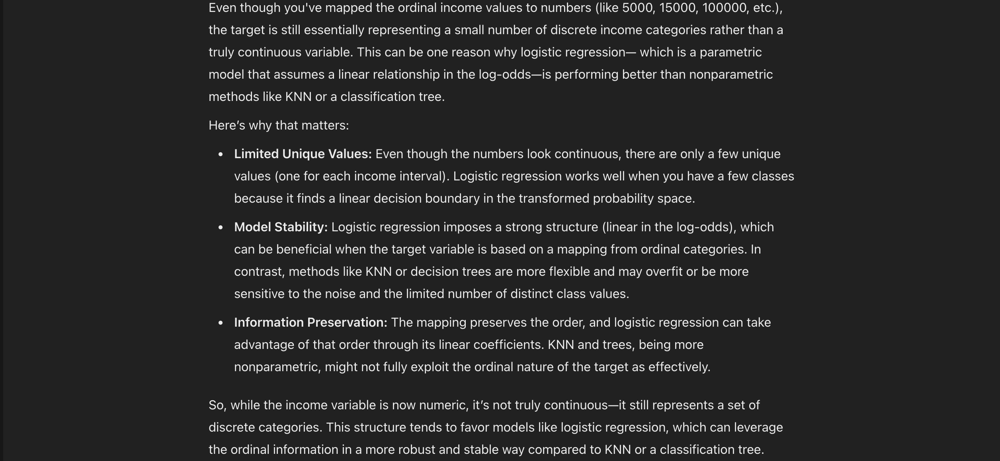

In [59]:
# Laver samme statistik som før:
logreg_errors = results_df_class['logreg_error'].tolist()
knn_errors    = results_df_class['knn_error'].tolist()
baseline_errors = results_df_class['baseline_error'].tolist()

print("Logistic Regression errors:", logreg_errors)
print("KNN errors:", knn_errors)
print("Baseline errors:", baseline_errors)

t_stat, p_val, ci = paired_ttest(logreg_errors, knn_errors, alpha=0.05)
print("\nPaired t-test for Logistic Regression vs. KNN:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")

t_stat, p_val, ci = paired_ttest(logreg_errors, baseline_errors, alpha=0.05)
print("\nPaired t-test for Logistic Regression vs. Baseline:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")

t_stat, p_val, ci = paired_ttest(knn_errors, baseline_errors, alpha=0.05)
print("\nPaired t-test for KNN vs. Baseline:")
print(f"t-statistic: {t_stat:.3f}")
print(f"p-value:     {p_val:.8f}")
print(f"95% CI:      [{ci[0]:.3f}, {ci[1]:.3f}]")

Logistic Regression errors: [0.6533333333333333, 0.65, 0.6488888888888888, 0.6685205784204672, 0.699666295884316, 0.6662958843159066, 0.6484983314794216, 0.6407119021134594, 0.6874304783092324, 0.64293659621802]
KNN errors: [0.6766666666666666, 0.6611111111111111, 0.6622222222222223, 0.675194660734149, 0.6985539488320356, 0.7074527252502781, 0.664071190211346, 0.6496106785317018, 0.692992213570634, 0.6729699666295884]
Baseline errors: [0.8088888888888889, 0.7777777777777778, 0.81, 0.8209121245828699, 0.814238042269188, 0.8153503893214683, 0.7897664071190211, 0.8008898776418243, 0.8253615127919911, 0.796440489432703]

Paired t-test for Logistic Regression vs. KNN:
t-statistic: -3.849
p-value:     0.00390995
95% CI:      [-0.025, -0.006]

Paired t-test for Logistic Regression vs. Baseline:
t-statistic: -30.601
p-value:     0.00000000
95% CI:      [-0.156, -0.135]

Paired t-test for KNN vs. Baseline:
t-statistic: -27.840
p-value:     0.00000000
95% CI:      [-0.140, -0.119]


# Resultater:  
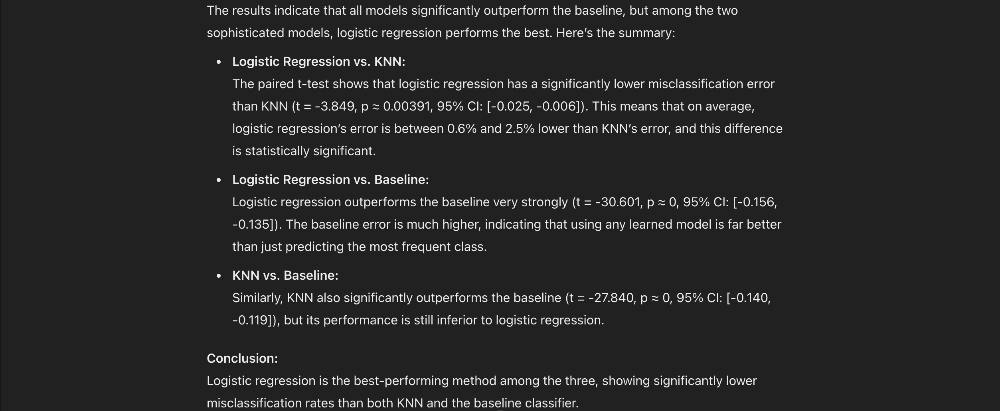